# No-show Prediction With CatBoost

## Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import shap

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, RocCurveDisplay, roc_auc_score, f1_score
from sklearn.base import BaseEstimator, TransformerMixin
from category_encoders import TargetEncoder
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV

import sys
import os
sys.path.append(os.path.abspath(".."))
from common_functions import optimal_f1_search

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Dataset Import

In [2]:
data = pd.read_parquet("../../data/hotel_booking_optimized.parquet")
data.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Ernest Barnes,Ernest.Barnes31@outlook.com,669-792-1661,************4322
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Andrea Baker,Andrea_Baker94@aol.com,858-637-6955,************9157
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Rebecca Parker,Rebecca_Parker@comcast.net,652-885-2745,************3734
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Laura Murray,Laura_M@gmail.com,364-656-8427,************5677
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,Transient,98.0,0,1,Check-Out,2015-07-03,Linda Hines,LHines@verizon.com,713-226-5883,************5498


## Pipeline

Will use similar approach as with the cancellation model, since the dataset is the same.

In [6]:
# Preparing the target variable
data["no_show"] = data["reservation_status"].apply(lambda x: 1 if x == "No-Show" else 0)
data["no_show"].value_counts()

no_show
0    118182
1      1207
Name: count, dtype: int64

CatBoost offers a simple way to deal with the obvious class imbalance, so there is no need to use the imblearn library here. We will just define the class weights for now. The ratio is roughly 1:98, but we will use 1:60 to avoid overcompensating.

In [9]:
class_weights = [1, 60]

In [7]:
# A function to map week number to season
def week_to_season(week):
    if 10 <= week <= 21:
        return 'Spring'
    elif 22 <= week <= 34:
        return 'Summer'
    elif 35 <= week <= 47:
        return 'Fall'
    else:
        return 'Winter'

data["total_stay"] = data["stays_in_weekend_nights"] + data["stays_in_week_nights"]
data["adr_per_person"] = data["adr"] / (data["adults"] + data["children"] + data["babies"])
data["arrival_season"] = data["arrival_date_week_number"].apply(week_to_season)

In [8]:
# Columns for one-hot encoding (low-cardinality categorical)
onehot_cols = [
    "hotel", "meal", "market_segment", "distribution_channel",
    "customer_type", "deposit_type", "arrival_date_month", "arrival_season"
]

# Columns for target encoding (high-cardinality categorical)
target_cols = ["agent", "country"]

# Numeric / passthrough columns
numeric_cols = [
    "lead_time", "arrival_date_year", "arrival_date_week_number",
    "arrival_date_day_of_month", "stays_in_weekend_nights", "stays_in_week_nights",
    "adults", "children", "babies", "previous_cancellations",
    "previous_bookings_not_canceled", "days_in_waiting_list",
    "adr", "required_car_parking_spaces", "total_of_special_requests",
    "is_repeated_guest", "total_stay", "adr_per_person"
]

# Unincluded columns will be dropped in the preprocessing step
# is_canceled dropped as well, since it doesn't make sense to use it as a feature
# noshow dropped since it's the target variable

In [10]:
# Target encoding for high-cardinality categorical features
target_encoder = TargetEncoder(cols=target_cols, smoothing=5)  # CV-safe inside pipeline

# ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ("target", target_encoder, target_cols),
        ("onehot", OneHotEncoder(handle_unknown="ignore"), onehot_cols),
        ("numeric", "passthrough", numeric_cols)
    ]
)

In [11]:
pipeline_1 = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds - increase for better performance
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42,
        class_weights=class_weights # handling class imbalance
    ))
])

## Train/Test Split

In [12]:
X = data.drop("no_show", axis=1)
y = data["no_show"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

## First Model

### Parameters to search for

In [13]:
param_distributions_1 = {
    'model__depth': [4, 6, 8, 10],
    'model__learning_rate': [0.01, 0.03, 0.05, 0.1],
    'model__l2_leaf_reg': [1, 3, 5, 7, 9],
    'model__bagging_temperature': [0, 1, 2, 5],
    'model__border_count': [32, 64, 128, 254],
    'model__min_data_in_leaf': [1, 5, 10, 20],
    'model__colsample_bylevel': [0.6, 0.8, 1.0]
}

### Randomized search setup

In [15]:
random_search_1 = RandomizedSearchCV(
    pipeline_1,
    param_distributions=param_distributions_1,
    n_iter=50, # Number of random combinations to try
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1, # Use 1 to avoid potential GPU conflicts
    random_state=42
)

### Search

In [17]:
random_search_1.fit(X_train, y_train)

cat_boost_pipeline_1 = random_search_1.best_estimator_
cat_boost_pipeline_1

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
[CV 2/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
[CV 3/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
0:	learn: 0.6153279	total: 2.43s	remaining: 1h 41m 14s
1:	learn: 0.5644465	total: 2.44s	remaining: 50m 43s
2:	learn: 0.5228949	total: 2.44s	remaining: 33m 53s
3:	learn: 0.4966547	total: 2.45s	remaining: 25m 28s
4:	learn: 0.4766592	total: 2.46s	remaining: 20m 25s
5:	learn: 0.

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py:516: FitFailedWarning: 
99 fits failed out of a total of 150.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
99 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py", line 859, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\base.py", line 1365, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Sebastijan\anaconda3

0:	learn: 0.6868695	total: 5.51ms	remaining: 13.8s
1:	learn: 0.6800007	total: 10ms	remaining: 12.5s
2:	learn: 0.6741054	total: 14.4ms	remaining: 12s
3:	learn: 0.6684340	total: 18.8ms	remaining: 11.8s
4:	learn: 0.6629962	total: 23.4ms	remaining: 11.7s
5:	learn: 0.6567263	total: 27.9ms	remaining: 11.6s
6:	learn: 0.6518317	total: 32.4ms	remaining: 11.5s
7:	learn: 0.6467863	total: 36.9ms	remaining: 11.5s
8:	learn: 0.6419368	total: 44.9ms	remaining: 12.4s
9:	learn: 0.6373482	total: 56.5ms	remaining: 14.1s
10:	learn: 0.6327799	total: 68.1ms	remaining: 15.4s
11:	learn: 0.6289281	total: 78ms	remaining: 16.2s
12:	learn: 0.6241006	total: 87ms	remaining: 16.6s
13:	learn: 0.6202412	total: 97.5ms	remaining: 17.3s
14:	learn: 0.6168869	total: 112ms	remaining: 18.5s
15:	learn: 0.6133118	total: 123ms	remaining: 19.1s
16:	learn: 0.6094834	total: 133ms	remaining: 19.4s
17:	learn: 0.6047751	total: 139ms	remaining: 19.2s
18:	learn: 0.6010138	total: 147ms	remaining: 19.2s
19:	learn: 0.5978950	total: 156ms	r

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [18]:
random_search_1.best_params_

{'model__min_data_in_leaf': 10,
 'model__learning_rate': 0.01,
 'model__l2_leaf_reg': 1,
 'model__depth': 4,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 32,
 'model__bagging_temperature': 2}

In [19]:
y_pred_train_1 = cat_boost_pipeline_1.predict(X_train)
y_pred_test_1 = cat_boost_pipeline_1.predict(X_test)

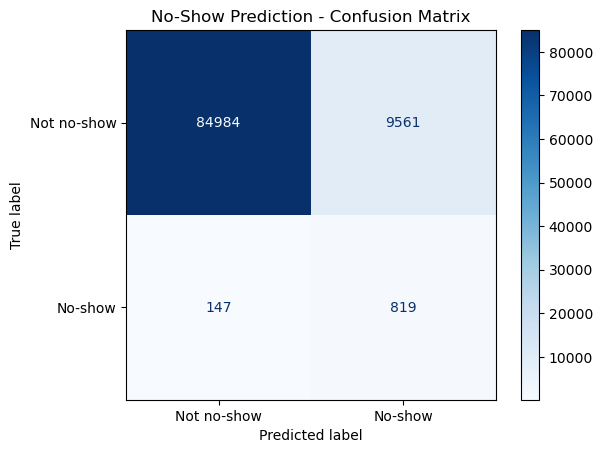

              precision    recall  f1-score   support

 Not no-show       1.00      0.90      0.95     94545
     No-show       0.08      0.85      0.14       966

    accuracy                           0.90     95511
   macro avg       0.54      0.87      0.55     95511
weighted avg       0.99      0.90      0.94     95511



In [38]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_1,
    display_labels=["Not no-show", "No-show"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("No-Show Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_1, target_names=["Not no-show", "No-show"]))

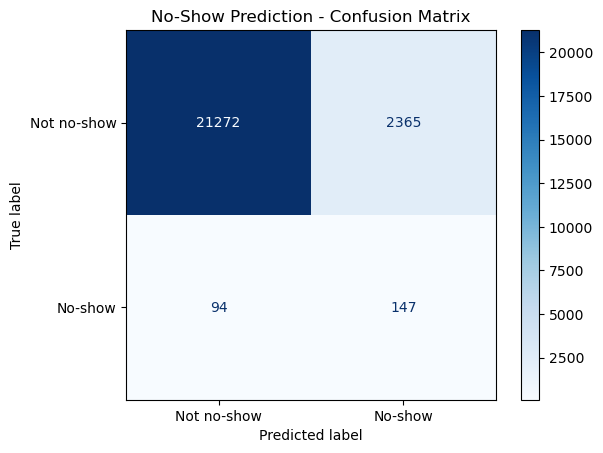

              precision    recall  f1-score   support

 Not no-show       1.00      0.90      0.95     23637
     No-show       0.06      0.61      0.11       241

    accuracy                           0.90     23878
   macro avg       0.53      0.75      0.53     23878
weighted avg       0.99      0.90      0.94     23878



In [37]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_1,
    display_labels=["Not no-show", "No-show"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("No-Show Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_1, target_names=["Not no-show", "No-show"]))

ROC-AUC: 0.8744451214663276


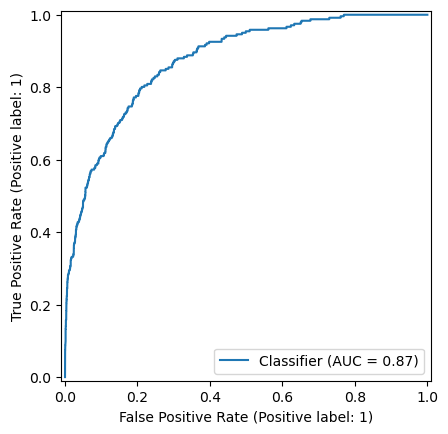

In [23]:
y_probs_1 = cat_boost_pipeline_1.predict_proba(X_test)[:,1]
auc_1 = roc_auc_score(y_test, y_probs_1)
print("ROC-AUC:", auc_1)

RocCurveDisplay.from_predictions(y_test, y_probs_1)
plt.show();

Best threshold: 0.84
Best F1: 0.27631578947368424


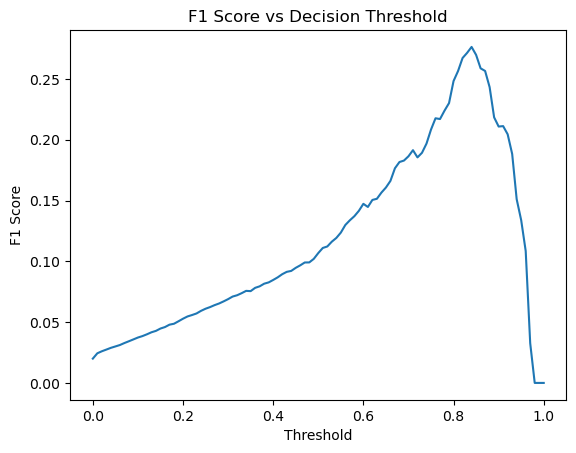

In [24]:
optimal_f1_search(y_test, y_probs_1)

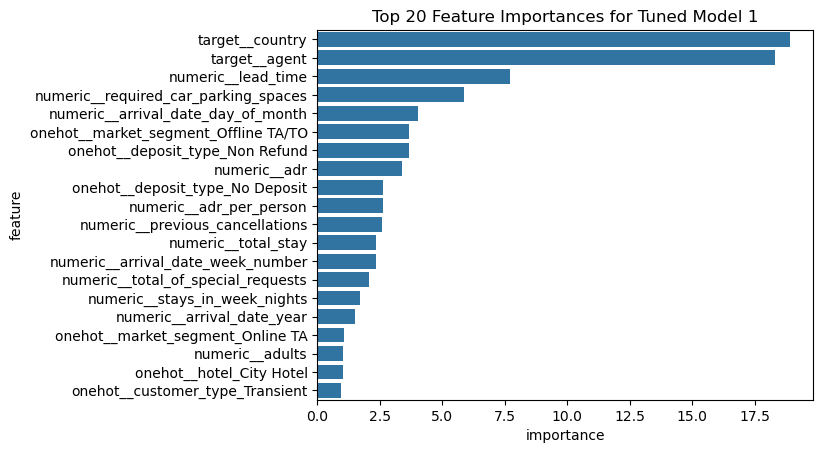

In [25]:
feature_names_1 = cat_boost_pipeline_1.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_1 = cat_boost_pipeline_1.named_steps['model']
importances_1 = tuned_cat_boost_model_1.feature_importances_

df_imp_1 = pd.DataFrame({
    'feature': feature_names_1,
    'importance': importances_1
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_1)
plt.title("Top 20 Feature Importances for Tuned Model 1")
plt.show();

The model does not perform great, but it's not too bad, considering the extreme imbalance. We will try again with different class weights.

## Second Model

### Pipeline with new class weights

In [26]:
class_weights_2 = [1, 15]

pipeline_2 = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds - increase for better performance
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42,
        class_weights=class_weights_2 # handling class imbalance
    ))
])

### Parameters to search for

In [27]:
## Same hyperparameter distributions as before, but rewritten for clarity
param_distributions_2 = {
    'model__depth': [4, 6, 8, 10],
    'model__learning_rate': [0.01, 0.03, 0.05, 0.1],
    'model__l2_leaf_reg': [1, 3, 5, 7, 9],
    'model__bagging_temperature': [0, 1, 2, 5],
    'model__border_count': [32, 64, 128, 254],
    'model__min_data_in_leaf': [1, 5, 10, 20],
    'model__colsample_bylevel': [0.6, 0.8, 1.0]
}

### Randomized search setup

In [28]:
random_search_2 = RandomizedSearchCV(
    pipeline_2,
    param_distributions=param_distributions_2,
    n_iter=50, # Number of random combinations to try
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1, # Use 1 to avoid potential GPU conflicts
    random_state=42
)

### Search

In [29]:
random_search_2.fit(X_train, y_train)

cat_boost_pipeline_2 = random_search_2.best_estimator_
cat_boost_pipeline_2

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
[CV 2/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
[CV 3/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
0:	learn: 0.5628710	total: 7.42ms	remaining: 18.5s
1:	learn: 0.4872277	total: 13.7ms	remaining: 17.2s
2:	learn: 0.4363071	total: 20ms	remaining: 16.6s
3:	learn: 0.3935842	total: 26.3ms	remaining: 16.4s
4:	learn: 0.3568212	total: 32.6ms	remaining: 16.3s
5:	learn: 0.3365119	to

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py:516: FitFailedWarning: 
99 fits failed out of a total of 150.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
99 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py", line 859, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\base.py", line 1365, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Sebastijan\anaconda3

0:	learn: 0.6817181	total: 3.42ms	remaining: 8.55s
1:	learn: 0.6705436	total: 6.69ms	remaining: 8.36s
2:	learn: 0.6592879	total: 9.79ms	remaining: 8.15s
3:	learn: 0.6499660	total: 12.7ms	remaining: 7.91s
4:	learn: 0.6411641	total: 15.7ms	remaining: 7.85s
5:	learn: 0.6302431	total: 19.2ms	remaining: 7.99s
6:	learn: 0.6217277	total: 22.8ms	remaining: 8.11s
7:	learn: 0.6111454	total: 26.3ms	remaining: 8.19s
8:	learn: 0.6020543	total: 30.2ms	remaining: 8.35s
9:	learn: 0.5931149	total: 34ms	remaining: 8.46s
10:	learn: 0.5856432	total: 37ms	remaining: 8.38s
11:	learn: 0.5773974	total: 40.2ms	remaining: 8.33s
12:	learn: 0.5707235	total: 43.5ms	remaining: 8.31s
13:	learn: 0.5635828	total: 46.6ms	remaining: 8.27s
14:	learn: 0.5558991	total: 49.6ms	remaining: 8.21s
15:	learn: 0.5494841	total: 52.7ms	remaining: 8.18s
16:	learn: 0.5433311	total: 56.2ms	remaining: 8.21s
17:	learn: 0.5374013	total: 59.5ms	remaining: 8.2s
18:	learn: 0.5311460	total: 62.8ms	remaining: 8.21s
19:	learn: 0.5254674	total:

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [30]:
random_search_2.best_params_

{'model__min_data_in_leaf': 10,
 'model__learning_rate': 0.01,
 'model__l2_leaf_reg': 1,
 'model__depth': 4,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 32,
 'model__bagging_temperature': 2}

In [31]:
y_pred_train_2 = cat_boost_pipeline_2.predict(X_train)
y_pred_test_2 = cat_boost_pipeline_2.predict(X_test)

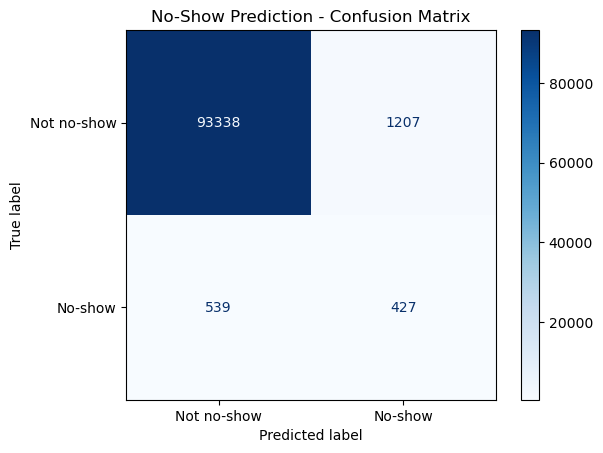

              precision    recall  f1-score   support

 Not no-show       0.99      0.99      0.99     94545
     No-show       0.26      0.44      0.33       966

    accuracy                           0.98     95511
   macro avg       0.63      0.71      0.66     95511
weighted avg       0.99      0.98      0.98     95511



In [32]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_2,
    display_labels=["Not no-show", "No-show"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("No-Show Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_2, target_names=["Not no-show", "No-show"]))

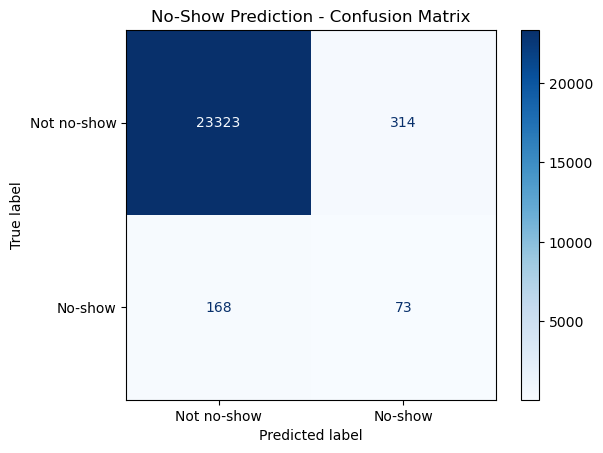

              precision    recall  f1-score   support

 Not no-show       0.99      0.99      0.99     23637
     No-show       0.19      0.30      0.23       241

    accuracy                           0.98     23878
   macro avg       0.59      0.64      0.61     23878
weighted avg       0.98      0.98      0.98     23878



In [39]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_2,
    display_labels=["Not no-show", "No-show"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("No-Show Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_2, target_names=["Not no-show", "No-show"]))

ROC-AUC: 0.8739265589833226


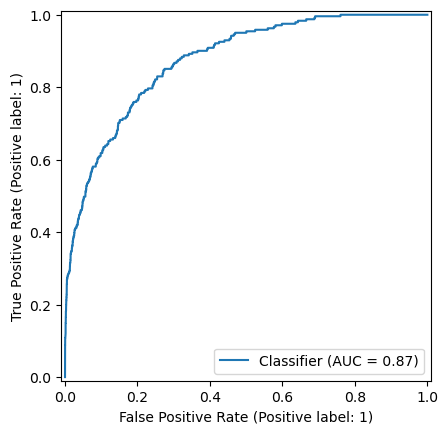

In [34]:
y_probs_2 = cat_boost_pipeline_2.predict_proba(X_test)[:,1]
auc_2 = roc_auc_score(y_test, y_probs_2)
print("ROC-AUC:", auc_2)

RocCurveDisplay.from_predictions(y_test, y_probs_2)
plt.show();

Best threshold: 0.63
Best F1: 0.2988505747126437


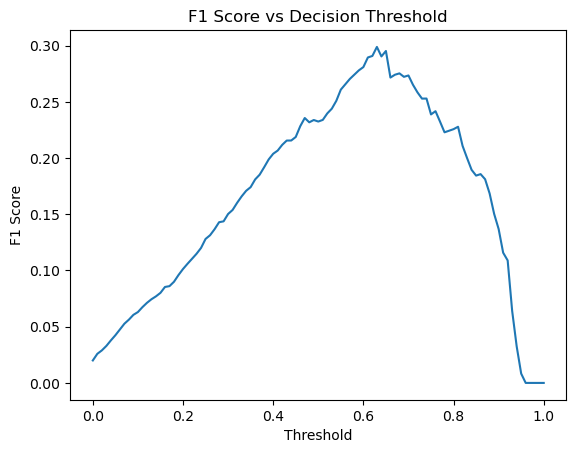

In [35]:
optimal_f1_search(y_test, y_probs_2)

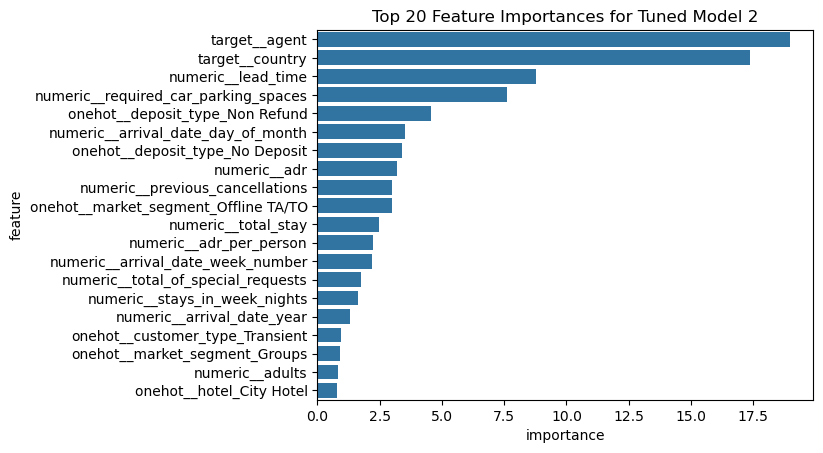

In [36]:
feature_names_2 = cat_boost_pipeline_2.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_2 = cat_boost_pipeline_2.named_steps['model']
importances_2 = tuned_cat_boost_model_2.feature_importances_

df_imp_2 = pd.DataFrame({
    'feature': feature_names_2,
    'importance': importances_2
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_2)
plt.title("Top 20 Feature Importances for Tuned Model 2")
plt.show();

## Third Model

### Pipeline

In [40]:
class_weights_3 = [1, 15]

# Same as pipeline_2 but defined separately for clarity
pipeline_3 = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds - increase for better performance
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42,
        class_weights=class_weights_3 # handling class imbalance
    ))
])

### Parameters to search for

In [41]:
param_distributions_3 = {
    'model__depth': [2, 3, 4, 5],
    'model__learning_rate': [0.001, 0.005, 0.01, 0.02],
    'model__l2_leaf_reg': [1, 2],
    'model__bagging_temperature': [2, 3],
    'model__border_count': [32], # will stick to 32 based on previous results
    'model__min_data_in_leaf': [8, 10, 12, 14],
    'model__colsample_bylevel': [1.0] # will stick to 1.0 based on previous results
}

### Randomized search setup

In [42]:
random_search_3 = RandomizedSearchCV(
    pipeline_3,
    param_distributions=param_distributions_3,
    n_iter=50, # Number of random combinations to try
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1, # Use 1 to avoid potential GPU conflicts
    random_state=42
)

### Search

In [43]:
random_search_3.fit(X_train, y_train)

cat_boost_pipeline_3 = random_search_3.best_estimator_
cat_boost_pipeline_3

Fitting 3 folds for each of 50 candidates, totalling 150 fits
0:	learn: 0.6880258	total: 3.87ms	remaining: 9.68s
1:	learn: 0.6826227	total: 7.19ms	remaining: 8.98s
2:	learn: 0.6760501	total: 10.5ms	remaining: 8.74s
3:	learn: 0.6699236	total: 14ms	remaining: 8.72s
4:	learn: 0.6645000	total: 17.3ms	remaining: 8.63s
5:	learn: 0.6586587	total: 20.6ms	remaining: 8.58s
6:	learn: 0.6537882	total: 24.1ms	remaining: 8.57s
7:	learn: 0.6489859	total: 27.5ms	remaining: 8.55s
8:	learn: 0.6430786	total: 30.8ms	remaining: 8.52s
9:	learn: 0.6390298	total: 34.2ms	remaining: 8.51s
10:	learn: 0.6342910	total: 37.4ms	remaining: 8.46s
11:	learn: 0.6299983	total: 40.8ms	remaining: 8.46s
12:	learn: 0.6252128	total: 44.4ms	remaining: 8.5s
13:	learn: 0.6200787	total: 48ms	remaining: 8.52s
14:	learn: 0.6150876	total: 51.4ms	remaining: 8.51s
15:	learn: 0.6109804	total: 55ms	remaining: 8.53s
16:	learn: 0.6071688	total: 58.9ms	remaining: 8.6s
17:	learn: 0.6030584	total: 62.2ms	remaining: 8.58s
18:	learn: 0.5993598

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [44]:
random_search_3.best_params_

{'model__min_data_in_leaf': 10,
 'model__learning_rate': 0.005,
 'model__l2_leaf_reg': 2,
 'model__depth': 5,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 32,
 'model__bagging_temperature': 2}

In [45]:
y_pred_train_3 = cat_boost_pipeline_3.predict(X_train)
y_pred_test_3 = cat_boost_pipeline_3.predict(X_test)

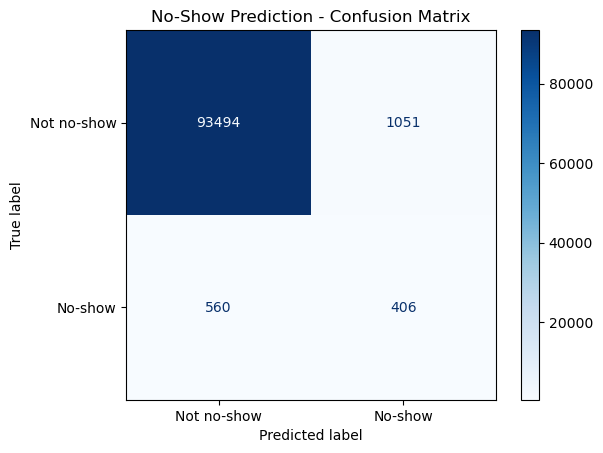

              precision    recall  f1-score   support

 Not no-show       0.99      0.99      0.99     94545
     No-show       0.28      0.42      0.34       966

    accuracy                           0.98     95511
   macro avg       0.64      0.70      0.66     95511
weighted avg       0.99      0.98      0.98     95511



In [46]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_3,
    display_labels=["Not no-show", "No-show"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("No-Show Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_3, target_names=["Not no-show", "No-show"]))

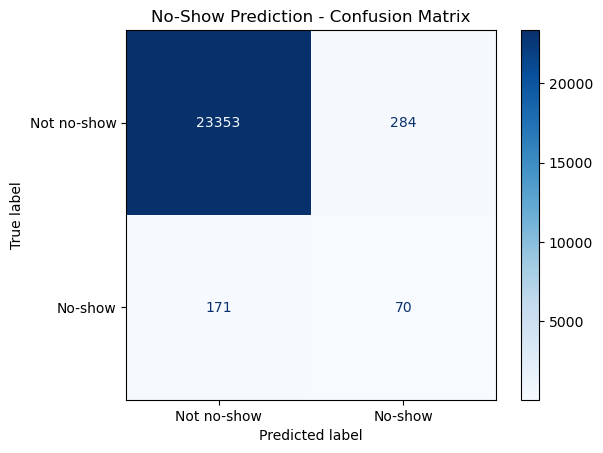

              precision    recall  f1-score   support

 Not no-show       0.99      0.99      0.99     23637
     No-show       0.20      0.29      0.24       241

    accuracy                           0.98     23878
   macro avg       0.60      0.64      0.61     23878
weighted avg       0.98      0.98      0.98     23878



In [47]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_3,
    display_labels=["Not no-show", "No-show"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("No-Show Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_3, target_names=["Not no-show", "No-show"]))

ROC-AUC: 0.872975451490797


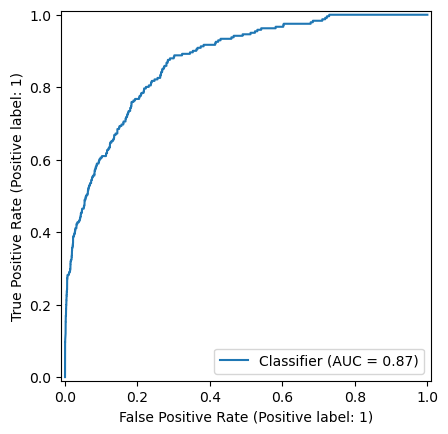

In [48]:
y_probs_3 = cat_boost_pipeline_3.predict_proba(X_test)[:,1]
auc_3 = roc_auc_score(y_test, y_probs_3)
print("ROC-AUC:", auc_3)

RocCurveDisplay.from_predictions(y_test, y_probs_3)
plt.show();

Best threshold: 0.6
Best F1: 0.2914798206278027


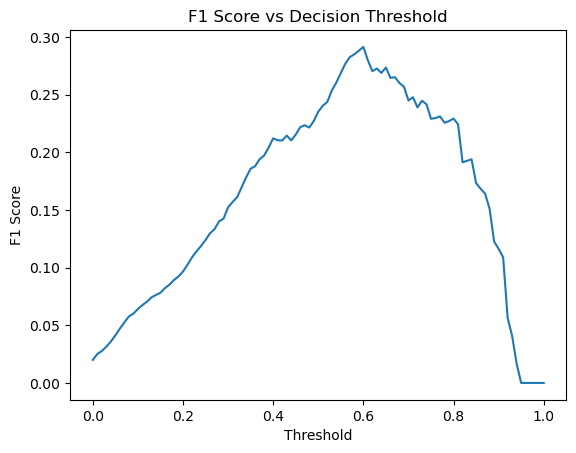

In [49]:
optimal_f1_search(y_test, y_probs_3)

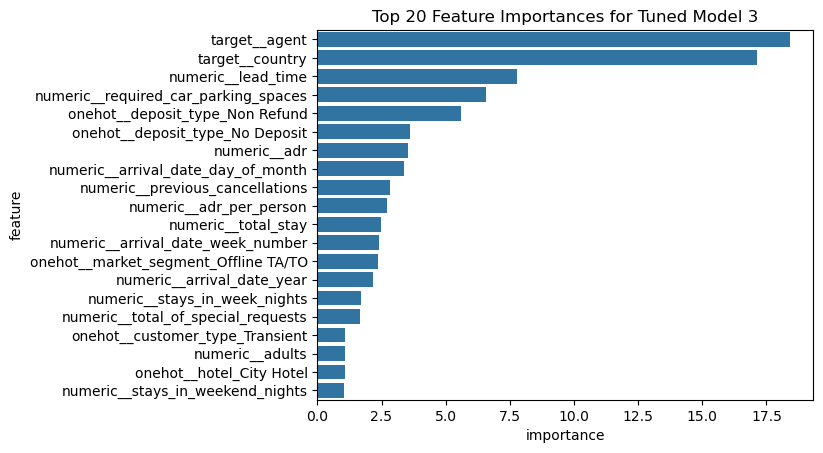

In [50]:
feature_names_3 = cat_boost_pipeline_3.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_3 = cat_boost_pipeline_3.named_steps['model']
importances_3 = tuned_cat_boost_model_3.feature_importances_

df_imp_3 = pd.DataFrame({
    'feature': feature_names_3,
    'importance': importances_3
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_3)
plt.title("Top 20 Feature Importances for Tuned Model 3")
plt.show();

## Saving the best model, f1 threshold, feature importances, and mean shap values

### Save model

In [51]:
# Custom transformer for engineered features
class FeatureEngineer(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    
    def fit(self, X, y=None):
        return self
    
    # A function to map week number to season
    def week_to_season(self, week):
        if 10 <= week <= 21:
            return 'Spring'
        elif 22 <= week <= 34:
            return 'Summer'
        elif 35 <= week <= 47:
            return 'Fall'
        else:
            return 'Winter'

    def transform(self, X):
        X = X.copy()
        # total_stay
        X['total_stay'] = X['stays_in_weekend_nights'] + X['stays_in_week_nights']
        # adr_per_person
        X['adr_per_person'] = X['adr'] / (X['adults'] + X['children'] + X['babies']).replace(0, 1)
        # arrival_season
        X['arrival_season'] = X['arrival_date_week_number'].apply(self.week_to_season)
        return X

In [52]:
pipeline_final = Pipeline([
    ("feature_engineering", FeatureEngineer()),
    ("preprocessing", preprocessor),
    ("model", CatBoostClassifier(
        iterations=2500,
        task_type='CPU', # using CPU for production environment
        # devices='0', # not needed for CPU
        verbose=1,
        early_stopping_rounds=100,
        random_state=42,
        class_weights=class_weights_3,
        **{key.replace('model__', ''): value for key, value in random_search_3.best_params_.items() if key.startswith('model__')}
    ))
])

In [53]:
pipeline_final.fit(X_train, y_train)

0:	learn: 0.6868012	total: 10.6ms	remaining: 26.4s
1:	learn: 0.6807618	total: 19.6ms	remaining: 24.5s
2:	learn: 0.6761455	total: 29.1ms	remaining: 24.2s
3:	learn: 0.6706310	total: 38ms	remaining: 23.7s
4:	learn: 0.6648395	total: 46.8ms	remaining: 23.4s
5:	learn: 0.6582907	total: 55.9ms	remaining: 23.3s
6:	learn: 0.6537096	total: 65.3ms	remaining: 23.3s
7:	learn: 0.6493730	total: 74ms	remaining: 23.1s
8:	learn: 0.6441817	total: 82.8ms	remaining: 22.9s
9:	learn: 0.6396492	total: 92.1ms	remaining: 22.9s
10:	learn: 0.6355007	total: 101ms	remaining: 22.9s
11:	learn: 0.6311595	total: 110ms	remaining: 22.8s
12:	learn: 0.6266466	total: 119ms	remaining: 22.8s
13:	learn: 0.6225875	total: 129ms	remaining: 22.9s
14:	learn: 0.6184051	total: 138ms	remaining: 22.8s
15:	learn: 0.6144290	total: 147ms	remaining: 22.9s
16:	learn: 0.6103320	total: 156ms	remaining: 22.8s
17:	learn: 0.6054702	total: 165ms	remaining: 22.8s
18:	learn: 0.6009349	total: 175ms	remaining: 22.9s
19:	learn: 0.5960480	total: 185ms	r

,steps,"[('feature_engineering', ...), ('preprocessing', ...), ...]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [54]:
joblib.dump(pipeline_final, "../../models/catboost_no_show_model_final.joblib")

['../../models/catboost_no_show_model_final.joblib']

### Save feature importances

In [55]:
df_imp_3.to_csv("../../models/catboost_no_show_model_final_feature_importances.csv", index=False)

### Save shap values

In [56]:
X_sample = X_test.copy()
X_sample.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card,total_stay,adr_per_person,arrival_season
56573,City Hotel,1,433,2016,September,37,8,0,3,2,...,0,Canceled,2015-10-20,John Macias,John.Macias23@comcast.net,796-702-8278,************1253,3,35.000000,Fall
33422,Resort Hotel,0,0,2017,February,8,22,0,1,2,...,0,Check-Out,2017-02-23,Henry Davis,Davis_Henry@aol.com,627-938-4331,************7529,1,34.000000,Winter
25351,Resort Hotel,0,168,2016,June,25,16,2,5,2,...,0,Check-Out,2016-06-23,Ariel Ayers,Ariel.A@yandex.com,425-716-3760,************1089,7,35.200001,Summer
41825,City Hotel,0,50,2015,August,35,25,0,4,1,...,0,Check-Out,2015-08-29,Victoria Guzman,Victoria_G@yahoo.com,302-558-6663,************1849,4,0.000000,Fall
109439,City Hotel,0,112,2017,April,14,8,2,2,2,...,1,Check-Out,2017-04-12,Bradley Carter,BCarter@att.com,826-099-5334,************6946,4,49.500000,Spring


In [57]:
X_transformed = pipeline_final[:-1].transform(X_sample)

In [58]:
catboost_model = pipeline_final.named_steps['model']

explainer = shap.TreeExplainer(catboost_model)

shap_values = explainer(X_transformed)

In [59]:
onehot_feature_names = pipeline_final.named_steps['preprocessing'].named_transformers_['onehot'].get_feature_names_out()
feature_names = np.concatenate([target_cols, onehot_feature_names, numeric_cols])

print(feature_names.shape)

(63,)


In [60]:
shap_df = pd.DataFrame(shap_values.values, columns=feature_names)
shap_df

,agent,country,hotel_City Hotel,hotel_Resort Hotel,meal_BB,meal_FB,meal_HB,meal_SC,meal_Undefined,market_segment_Aviation,...,babies,previous_cancellations,previous_bookings_not_canceled,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,is_repeated_guest,total_stay,adr_per_person
0,-1.377408,1.077302,-0.010307,0.004408,0.007587,0.001628,0.015359,0.004678,0.004541,-0.001666,...,0.000822,0.107719,0.008792,0.033994,0.117360,0.142449,-0.036050,0.005072,-0.056339,0.009852
1,0.453963,-0.690872,-0.032960,-0.023549,-0.002427,0.001945,0.011683,-0.011157,0.003167,-0.002928,...,0.001069,0.039625,0.005416,0.018888,-0.014486,-2.651301,-0.013944,0.003607,-0.003516,-0.021870
2,-0.777808,-1.608312,-0.026614,-0.075006,0.002598,0.001290,0.015272,0.001223,0.004441,-0.001428,...,0.001087,0.063574,0.006671,0.025463,0.090204,0.154626,-0.057448,0.004368,0.074216,0.012555
3,-2.301425,1.062231,0.004567,0.025922,0.010932,0.002636,0.018858,0.008141,0.004574,-0.001614,...,0.001087,0.104265,0.008980,0.031388,-0.031783,0.142012,-0.012315,0.002715,0.000138,-0.071787
4,0.638321,-1.755360,0.029206,0.018069,0.007169,0.001876,0.015018,-0.002188,0.003605,-0.001798,...,0.001076,0.045599,0.006332,0.021268,0.002477,0.156634,-0.018615,0.002004,-0.034914,-0.003162
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23873,0.009100,0.874625,-0.069436,-0.090776,0.003379,0.000654,0.016563,-0.005337,0.004837,-0.001359,...,0.001285,0.086461,0.012827,0.028025,0.113571,0.175307,0.048440,0.007498,0.109991,0.011720
23874,-2.433734,-1.066974,0.004205,0.013825,0.011630,0.003279,0.019268,0.001943,0.004619,-0.001435,...,0.000559,0.069992,0.005223,0.026185,0.074807,0.138503,-0.025203,0.001200,-0.017706,-0.021810
23875,-0.225337,0.814326,-0.047704,-0.085879,-0.009586,0.000721,-0.131695,0.005712,0.004246,-0.000255,...,0.000236,0.078132,0.007498,0.025935,-0.335678,-2.806307,-0.031672,0.001214,0.091401,0.034066
23876,0.501224,0.003600,0.031935,0.033159,0.006910,0.001858,0.014650,0.003168,0.004181,-0.001678,...,0.001000,0.062058,0.007767,0.026309,-0.109288,0.163232,0.047308,0.001459,-0.060976,0.004862


In [61]:
shap_abs_mean = np.abs(shap_values.values).mean(axis=0)
shap_df_global = pd.DataFrame({
    'feature': feature_names,
    'mean_abs_shap': shap_abs_mean
}).sort_values(by='mean_abs_shap', ascending=False)

shap_df_global

,feature,mean_abs_shap
1,country,9.827656e-01
0,agent,7.735882e-01
58,required_car_parking_spaces,3.185254e-01
27,deposit_type_Non Refund,1.993781e-01
45,lead_time,1.764093e-01
...,...,...
19,distribution_channel_GDS,7.608175e-04
28,deposit_type_Refundable,6.498864e-04
10,market_segment_Complementary,5.151759e-04
21,distribution_channel_Undefined,3.204080e-06


In [62]:
shap_df_global.to_csv("../../models/catboost_no_show_model_final_shap_importances.csv", index=False)

## END OF FILE